In [1]:
%matplotlib inline

In [2]:
import utils; reload(utils)
from utils import *
from tqdm import tqdm

Using gpu device 0: Tesla K80 (CNMeM is disabled, cuDNN 5103)
/home/ubuntu/anaconda2/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)
Using Theano backend.


In [3]:
# Create paths and make sure they exist

# path = "/home/ubuntu/ofir/data/statefarm/sample/"
path = "/home/ubuntu/ofir/data/statefarm/"
model_path = path + 'models/'
train_path = path + 'train/'
valid_path = path + 'valid/'
test_path = path + 'test/'
arrays_path = path + 'arrays/'

%mkdir -p '$path'
%mkdir -p '$model_path'
%mkdir -p '$train_path'
%mkdir -p '$valid_path'
%mkdir -p '$test_path'
%mkdir -p '$arrays_path'

batch_size=64

classes = os.listdir(train_path)

In [4]:
# Create samples dir

def create_sample_dir():

    org_train_path = os.path.join(path, '..', 'train',)
    classes = os.listdir(org_train_path)

    for c in classes:

        class_path = os.path.join(train_path, c)
        org_class_path = os.path.join(org_train_path, c)

        %mkdir -p '$class_path'

        for f in tqdm(os.listdir(org_class_path)[:300]):
            %cp '$org_class_path'/'$f' '$class_path'
            
# create_sample_dir()

In [5]:
# Create a validation dir

def create_valid_set():
    classes = os.listdir(train_path)

    for c in classes[1:]:

        train_class_dir = os.path.join(train_path, c)
        valid_class_dir = os.path.join(valid_path, c)

        # Select 10% of the images in the class dir
        imgs = np.array(os.listdir(train_class_dir))
        valid_imgs = np.random.choice(imgs, len(imgs) / 10, replace=False)

        # Move the selected images from their train dir to their respective valid dir
        %mkdir -p '$valid_class_dir'
        for img in tqdm(valid_imgs):
            %mv '$train_class_dir'/'$img' '$valid_class_dir'
            

# create_valid_set()

In [64]:
driver_list = pd.read_csv(path + 'driver_imgs_list.csv')

In [80]:
# This code undoes the original split between validation and training

# for c in tqdm(classes):
    
#     train_class_dir = os.path.join(train_path, c)
#     valid_class_dir = os.path.join(valid_path, c)
    
#     # Move all of the images from the valid_path back to the train_path
#     %mv '$valid_class_dir'/img_* '$train_class_dir'

100%|██████████| 10/10 [00:01<00:00,  6.24it/s]


In [83]:
def create_valid_set_2():
    driver_list.head()

    for driver in driver_list['subject'].unique()[:5]:
        for c in tqdm(classes):

            train_class_dir = os.path.join(train_path, c)
            valid_class_dir = os.path.join(valid_path, c)

            for img in driver_list[(driver_list['subject'] == driver) & (driver_list['classname'] == c)]['img']:
                %mv '$train_class_dir'/'$img' '$valid_class_dir'

,subject,classname,img
0,p002,c0,img_44733.jpg
1,p002,c0,img_72999.jpg
2,p002,c0,img_25094.jpg
3,p002,c0,img_69092.jpg
4,p002,c0,img_92629.jpg


## Start with a VGG16 model with only the last layer FT-ed

In [131]:
vgg_model = vgg_ft(len(classes))

In [132]:
vgg_model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
lambda_5 (Lambda)                (None, 3, 224, 224)   0           lambda_input_5[0][0]             
____________________________________________________________________________________________________
zeropadding2d_53 (ZeroPadding2D) (None, 3, 226, 226)   0           lambda_5[0][0]                   
____________________________________________________________________________________________________
convolution2d_53 (Convolution2D) (None, 64, 224, 224)  0           zeropadding2d_53[0][0]           
____________________________________________________________________________________________________
zeropadding2d_54 (ZeroPadding2D) (None, 64, 226, 226)  0           convolution2d_53[0][0]           
___________________________________________________________________________________________

In [133]:
vgg_model.compile(optimizer=RMSprop(lr=0.0001), metrics=['accuracy'], loss='categorical_crossentropy')

In [134]:
trn_batches = get_batches(train_path, batch_size=batch_size)
val_batches = get_batches(valid_path, batch_size=batch_size, shuffle=False)

Found 18047 images belonging to 10 classes.
Found 4377 images belonging to 10 classes.


In [135]:
vgg_model.fit_generator(
    trn_batches, 
    samples_per_epoch=trn_batches.nb_sample,
    nb_epoch=1,
    validation_data=val_batches,
    nb_val_samples=val_batches.nb_sample,
)

Epoch 1/1
18047/18047 [==============================] - 554s - loss: 3.4304 - acc: 0.1654 - val_loss: 2.3974 - val_acc: 0.1951


In [136]:
vgg_model.save_weights(model_path + 'ns-f1.h5f')

In [137]:
vgg_model.fit_generator(
    trn_batches, 
    samples_per_epoch=trn_batches.nb_sample,
    nb_epoch=2,
    validation_data=val_batches,
    nb_val_samples=val_batches.nb_sample,
)

Epoch 1/2
18047/18047 [==============================] - 546s - loss: 2.3802 - acc: 0.3176 - val_loss: 2.4000 - val_acc: 0.2122
Epoch 2/2
18047/18047 [==============================] - 545s - loss: 1.8844 - acc: 0.4269 - val_loss: 2.4204 - val_acc: 0.2143


In [138]:
vgg_model.save_weights(model_path + 'ns-f2.h5f')

In [139]:
vgg_model.load_weights(model_path + 'ns-f2.h5f')

In [11]:
vgg_model.fit_generator(
    trn_batches, 
    samples_per_epoch=trn_batches.nb_sample,
    nb_epoch=2,
    validation_data=val_batches,
    nb_val_samples=val_batches.nb_sample,
)

Epoch 1/2
20187/20187 [==============================] - 600s - loss: 1.5780 - acc: 0.5015 - val_loss: 0.6836 - val_acc: 0.8413
Epoch 2/2
20187/20187 [==============================] - 591s - loss: 1.3816 - acc: 0.5492 - val_loss: 0.5983 - val_acc: 0.8623


In [12]:
vgg_model.save_weights(model_path + 'ns-f3.h5f')

In [10]:
vgg_model.load_weights(model_path + 'ns-f3.h5f')

## Do some predictions

In [140]:
def do_preds(model):
    test_batches = get_batches(test_path, batch_size=batch_size, shuffle=False)
    preds = model.predict_generator(test_batches, val_samples=test_batches.nb_sample)
    
    return test_batches, preds
    
def get_samples(test_batches, preds):
    
    sample_preds = preds[:15].clip(min=0.04, max=0.96)
    sample_filenames = test_batches.filenames[:15]
    
    sample_preds = sample_preds[:15].clip(min=0.04, max=0.96)
    
    for idx, spred in enumerate(sample_preds):
        plots([image.load_img(test_path + sample_filenames[idx])], titles=[spred])

In [90]:
test_batches = get_batches(test_path, batch_size=batch_size, shuffle=False)

Found 79726 images belonging to 1 classes.


In [96]:
preds = vgg_model.predict_generator(test_batches, val_samples=test_batches.nb_sample)

In [97]:
sample_preds = preds[:15].clip(min=0.04, max=0.96)
sample_filenames = test_batches.filenames[:15]

In [98]:
sample_preds = sample_preds[:15].clip(min=0.04, max=0.96)

In [99]:
sample_preds

array([[ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.96  ],
       [ 0.7834,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.171 ,  0.04  ],
       [ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.96  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ],
       [ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.9107,  0.04  ,  0.0608,  0.04  ],
       [ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.7153,  0.04  ,  0.04  ,  0.2791,  0.04  ],
       [ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.96  ,  0.04  ,  0.04  ],
       [ 0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.96  ,  0.04  ,  0.04  ],
       [ 0.04  ,  0.04  ,  0.96  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ],
       [ 0.1322,  0.04  ,  0.04  ,  0.8633,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ,  0.04  ],
       [ 0.04  ,  0.1253,  0.04  ,  0.7745,  0.04  ,  0.04  ,  0.04  ,  0.1001,  0.04  ,  0.04  ],
       [ 0

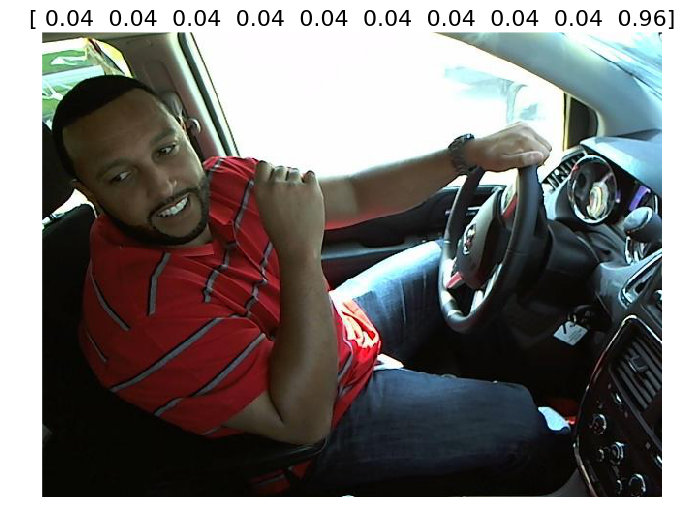

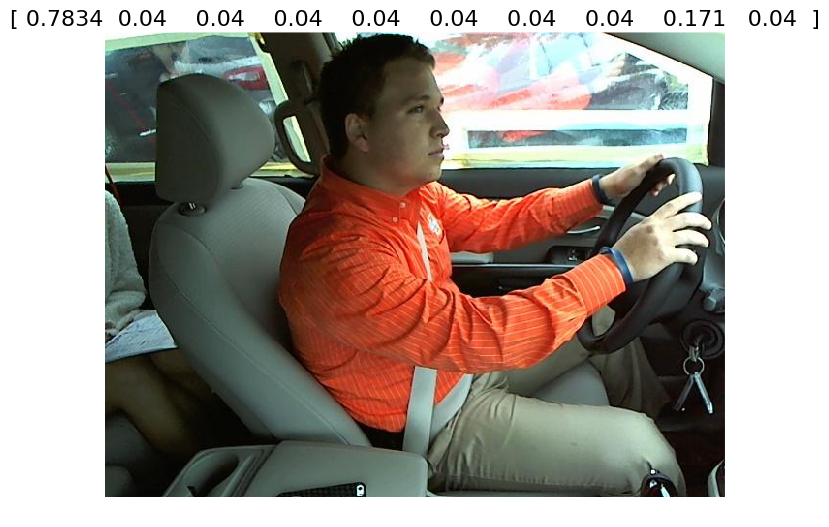

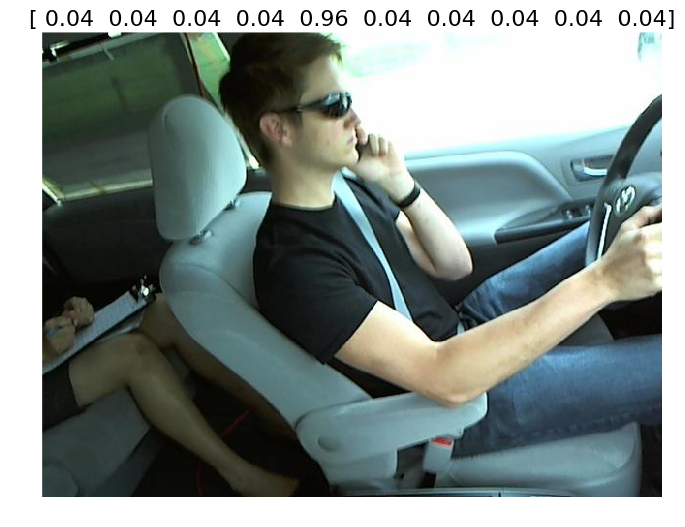

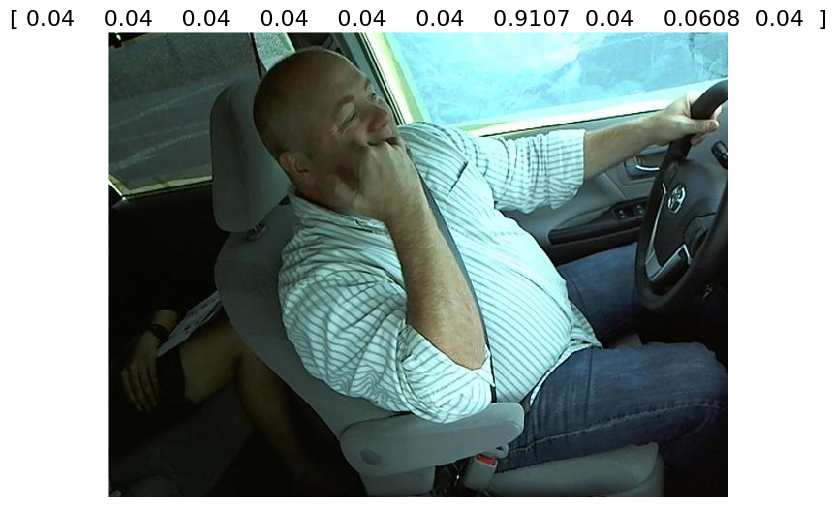

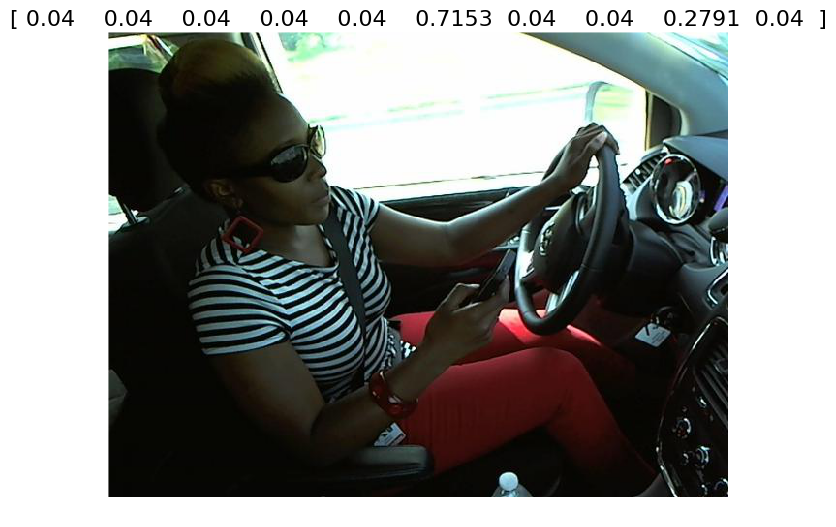

...

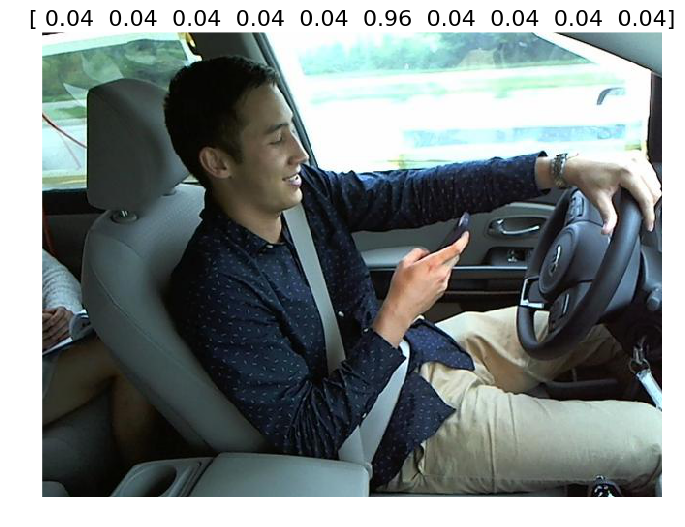

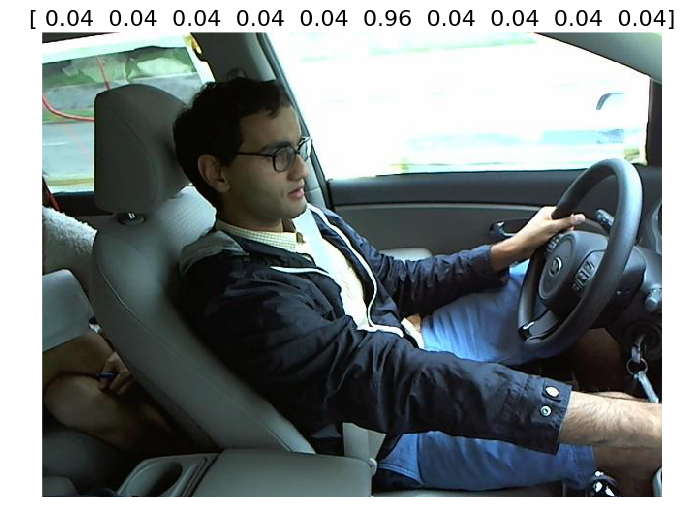

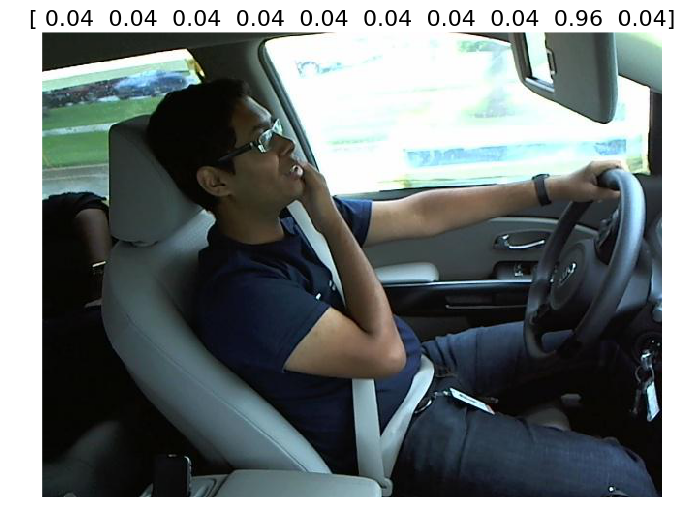

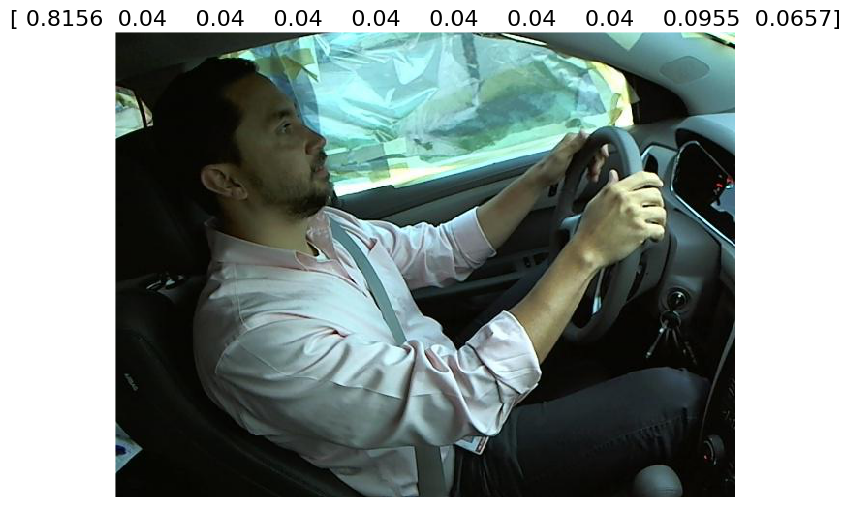

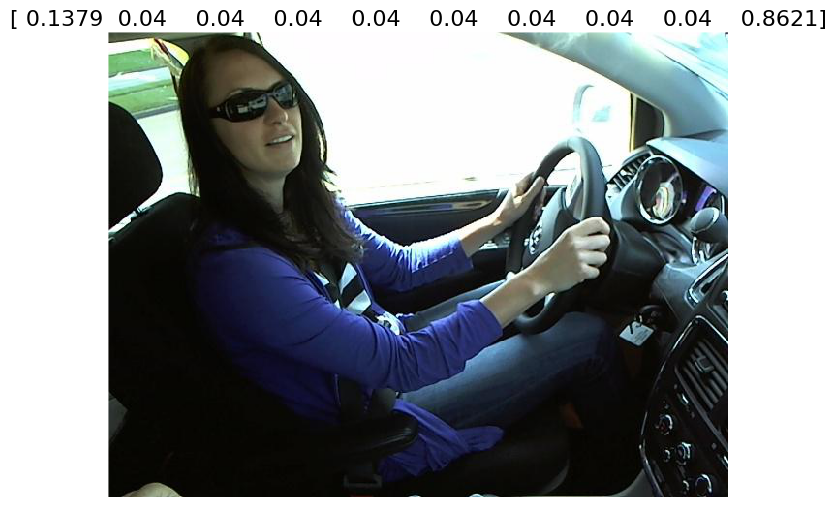

In [100]:
for idx, spred in enumerate(sample_preds):
    plots([image.load_img(test_path + sample_filenames[idx])], titles=[spred])

## Prepare submissions

In [101]:
preds

array([[  2.0760e-07,   8.2535e-09,   2.6703e-12, ...,   4.8398e-05,   1.7229e-05,   9.7942e-01],
       [  7.8345e-01,   3.1382e-04,   1.3100e-06, ...,   3.0572e-02,   1.7103e-01,   1.5254e-03],
       [  8.7539e-10,   7.7569e-17,   1.8003e-07, ...,   2.7286e-15,   1.3968e-06,   2.2039e-10],
       ..., 
       [  2.6599e-08,   3.8393e-10,   5.1686e-14, ...,   1.8780e-07,   2.5663e-07,   6.8635e-17],
       [  9.9936e-01,   1.9697e-07,   2.0059e-12, ...,   1.8464e-09,   1.3936e-08,   1.7647e-04],
       [  5.4654e-06,   6.7288e-14,   1.9372e-11, ...,   1.6549e-11,   1.0565e-10,   1.3933e-12]], dtype=float32)

In [12]:
def prepare_predictions(preds, filenames, min_pred=0.04, max_pred=0.96):
    
    # Create a DF
    res = pd.DataFrame(preds)
    
    # Add the image names
    res.insert(0, 'img', filenames)
    res['img'] = res['img'].apply(lambda x: x[len('unknown/'):])
    
    # Convert the label and prediction to numeric values (from strings)
    # And clip the predictions to min_pred, max_pred
    for i in range (0,10): 
        res[i] = pd.to_numeric(res[i])
        res[i] = res[i].clip(min_pred, max_pred)
    
    res.columns = ['img'] + ['c%s' % i for i in range(0,10)]
    
    return res

In [103]:
res = prepare_predictions(preds, test_batches.filenames)

In [104]:
res

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9
0,img_81601.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000
1,img_14887.jpg,0.783448,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.171032,0.040000
2,img_62885.jpg,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000
3,img_45125.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.910684,0.040000,0.060780,0.040000
4,img_22633.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.715252,0.040000,0.040000,0.279126,0.040000
5,img_45660.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
6,img_88962.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
7,img_92987.jpg,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000
8,img_26932.jpg,0.132185,0.040000,0.040000,0.863274,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000
9,img_57972.jpg,0.040000,0.125348,0.040000,0.774490,0.040000,0.040000,0.040000,0.100112,0.040000,0.040000


In [13]:
def write_csv(df, fname):
    df.to_csv(fname, index=False)

In [106]:
write_csv(res, 'statefarm-do0-f3.csv')

Things to do in order to improve the model:

1. Use the list of driver images in order to separate drivers between the validation and training sets. No driver should be in both sets.
1. Train more layers.
1. Remove\reduce dropout
1. Batch normalization
1. Data augmenetation

## Let's train on more layers + remove DO + add Batch Optimization

In [141]:
all_layers = vgg_model.layers

In [142]:
# Get the index of the last MaxPooling2D layer in the VGG model.
# All the layers to this index will not be trained and will be used to calculate the training/validation sets values before the FC layers.
# All the layers from this index (including) will be fine tuned.
flatten_layer_idx = len(vgg_model.layers) - next(idx for idx,layer in enumerate(reversed(vgg_model.layers)) if type(layer) == MaxPooling2D)

In [143]:
conv_layers = all_layers[:flatten_layer_idx]
conv_layers

In [144]:
fc_layers = all_layers[flatten_layer_idx:]
fc_layers

In [145]:
fc_layers[1].get_weights()

[array([[  1.9746e-05,   3.5309e-04,  -1.8328e-03, ...,   3.9865e-05,  -2.8763e-03,   3.3548e-03],
        [  4.5399e-04,  -1.6271e-03,  -2.2679e-03, ...,  -2.1454e-03,  -3.0396e-03,   2.8342e-04],
        [  5.5663e-04,  -3.1813e-03,  -1.5065e-03, ...,  -2.2823e-03,  -3.7002e-03,  -7.0679e-04],
        ..., 
        [  1.8427e-03,   6.4293e-04,   2.4107e-03, ...,  -1.9897e-03,   2.6534e-03,  -3.3772e-03],
        [ -2.0984e-04,   1.1995e-03,   1.3821e-03, ...,  -2.6909e-03,   1.5766e-04,  -4.7684e-03],
        [  6.6753e-04,   1.8267e-03,   1.1026e-03, ...,  -1.7053e-03,   1.8931e-03,  -5.1029e-03]], dtype=float32),
 array([-0.1887,  0.1266, -0.2996, ..., -0.1838,  0.1745, -0.1672], dtype=float32)]

In [146]:
conv_model = Sequential(conv_layers)

In [147]:
# Get the training/validation batches (no shuffle)
batch_size = 64
trn_batches = get_batches(train_path, batch_size=batch_size, class_mode='categorical', shuffle=False)
val_batches = get_batches(valid_path, batch_size=batch_size, class_mode='categorical', shuffle=False)

# Turn the classes into one hot encoded vectors
trn_classes = trn_batches.classes
val_classes = val_batches.classes

trn_labels = onehot(trn_classes)
val_labels = onehot(val_classes)

Found 18047 images belonging to 10 classes.
Found 4377 images belonging to 10 classes.


In [149]:
# Get the output of train/validate from the conv model. This will be used as input for the FC model
trn_features = conv_model.predict_generator(trn_batches, trn_batches.nb_sample)
val_features = conv_model.predict_generator(val_batches, val_batches.nb_sample)

In [148]:
trn_features.shape, val_features.shape

((18047, 512, 7, 7), (4377, 512, 7, 7))

In [150]:
save_array(arrays_path + 'lesson3-ns-trn-ft.data', trn_features)
save_array(arrays_path + 'lesson3-ns-val-ft.data', val_features)

save_array(arrays_path + 'lesson3-ns-trn-lbls.data', trn_labels)
save_array(arrays_path + 'lesson3-ns-val-lbls.data', val_labels)

In [151]:
trn_features = load_array(arrays_path + 'lesson3-ns-trn-ft.data')
val_features = load_array(arrays_path + 'lesson3-ns-val-ft.data')

trn_labels = load_array(arrays_path + 'lesson3-ns-trn-lbls.data')
val_labels = load_array(arrays_path + 'lesson3-ns-val-lbls.data')

In [152]:
conv_layers[-1].output_shape[1:]

(512, 7, 7)

In [153]:
# Create a FC model that's similar in structure to VGG's FC layers, but remove the dropout.

def get_fc_layers(p=0.0, with_batch_norm=False):
    
    layers = []
    layers.append(Flatten(input_shape=conv_layers[-1].output_shape[1:]))
    layers.append(Dense(4096, activation='relu'))
    layers.append(Dropout(p))
    
    if with_batch_norm: 
        layers.append(BatchNormalization())

    layers.append(Dense(4096, activation='relu'))
    layers.append(Dropout(p))

    if with_batch_norm: 
        layers.append(BatchNormalization())

    layers.append(Dense(len(classes), activation='softmax'))
    
    return layers

def get_fc_model(p=0.0, with_batch_norm=False):
    
    fc_model = Sequential(get_fc_layers(p, with_batch_norm))
    
    # TODO: Remove comments
#     fc_model.add(Flatten(input_shape=conv_layers[-1].output_shape[1:]))
#     fc_model.add(Dense(4096, activation='relu'))
#     fc_model.add(Dropout(p))
#     if with_batch_norm: 
#         fc_model.add(BatchNormalization())
#     fc_model.add(Dense(4096, activation='relu'))
#     fc_model.add(Dropout(p))
#     if with_batch_norm: 
#         fc_model.add(BatchNormalization())
#     fc_model.add(Dense(len(classes), activation='softmax'))
    
    # Load the weights to the FC model
    bn_idx_modifier = 0
    for idx, layer in enumerate(fc_model.layers):
        if type(layer) == BatchNormalization:
            bn_idx_modifier -= 1
        else:
            layer.set_weights(fc_layers[idx + bn_idx_modifier].get_weights())
    
    return fc_model

In [157]:
fc_model = get_fc_model(p=0.5, with_batch_norm=True)

opt = RMSprop(lr=0.00001, rho=0.7)
fc_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

In [158]:
fc_model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
flatten_12 (Flatten)             (None, 25088)         0           flatten_input_4[0][0]            
____________________________________________________________________________________________________
dense_39 (Dense)                 (None, 4096)          102764544   flatten_12[0][0]                 
____________________________________________________________________________________________________
dropout_23 (Dropout)             (None, 4096)          0           dense_39[0][0]                   
____________________________________________________________________________________________________
batchnormalization_9 (BatchNormal(None, 4096)          8192        dropout_23[0][0]                 
___________________________________________________________________________________________

In [159]:
fc_model.fit(
    trn_features, 
    trn_labels, 
    batch_size=batch_size, 
    nb_epoch=1, 
    validation_data=(val_features, val_labels)
)

Train on 18047 samples, validate on 4377 samples
Epoch 1/1
18047/18047 [==============================] - 28s - loss: 0.4621 - acc: 0.8516 - val_loss: 2.4220 - val_acc: 0.3260


In [27]:
def save_weights(filepath):
    # Move the weights from the FC model to the original VGG model
    for idx, layer in enumerate(fc_model.layers):
        vgg_model.layers[flatten_layer_idx + idx].set_weights(layer.get_weights())

    # Save the weights of the VGG model
    vgg_model.save_weights(filepath)

In [ ]:
save_weights(model_path + 'ns-do-f1.h5f')

In [81]:
vgg_model.load_weights(model_path + 'ns-do-f1.h5f')

In [83]:
fc_model.fit(
    trn_features, 
    trn_labels, 
    batch_size=batch_size, 
    nb_epoch=2, 
    validation_data=(val_features, val_labels)
)

Train on 20187 samples, validate on 2237 samples
Epoch 1/2
20187/20187 [==============================] - 30s - loss: 0.0068 - acc: 0.9984 - val_loss: 0.0328 - val_acc: 0.9924
Epoch 2/2
20187/20187 [==============================] - 29s - loss: 0.0018 - acc: 0.9996 - val_loss: 0.0202 - val_acc: 0.9951


In [94]:
vgg_model.layers[flatten_layer_idx + 1].get_weights()

[array([[ -5.1267e-05,   3.5170e-04,  -1.8326e-03, ...,   3.9865e-05,  -3.0339e-03,   3.2314e-03],
        [  4.6736e-04,  -1.6664e-03,  -2.2706e-03, ...,  -2.1454e-03,  -2.9820e-03,   3.1459e-04],
        [  5.5763e-04,  -3.2369e-03,  -1.5253e-03, ...,  -2.2823e-03,  -3.8055e-03,  -5.2424e-04],
        ..., 
        [  1.6784e-03,   1.1764e-03,   2.5785e-03, ...,  -1.9897e-03,   2.7227e-03,  -3.8842e-03],
        [ -4.8146e-04,   1.5583e-03,   1.4474e-03, ...,  -2.6909e-03,   3.4793e-04,  -5.0447e-03],
        [  1.0184e-03,   1.5454e-03,   1.3560e-03, ...,  -1.7053e-03,   2.2473e-03,  -5.2929e-03]], dtype=float32),
 array([-0.1887,  0.1266, -0.2998, ..., -0.1838,  0.1745, -0.1674], dtype=float32)]

In [90]:
fc_model.layers[1].get_weights()

[array([[ -5.1267e-05,   3.5170e-04,  -1.8326e-03, ...,   3.9865e-05,  -3.0339e-03,   3.2314e-03],
        [  4.6736e-04,  -1.6664e-03,  -2.2706e-03, ...,  -2.1454e-03,  -2.9820e-03,   3.1459e-04],
        [  5.5763e-04,  -3.2369e-03,  -1.5253e-03, ...,  -2.2823e-03,  -3.8055e-03,  -5.2424e-04],
        ..., 
        [  1.6784e-03,   1.1764e-03,   2.5785e-03, ...,  -1.9897e-03,   2.7227e-03,  -3.8842e-03],
        [ -4.8146e-04,   1.5583e-03,   1.4474e-03, ...,  -2.6909e-03,   3.4793e-04,  -5.0447e-03],
        [  1.0184e-03,   1.5454e-03,   1.3560e-03, ...,  -1.7053e-03,   2.2473e-03,  -5.2929e-03]], dtype=float32),
 array([-0.1887,  0.1266, -0.2998, ..., -0.1838,  0.1745, -0.1674], dtype=float32)]

In [91]:
save_weights(model_path + 'ns-do-f3.h5f')

In [17]:
vgg_model.load_weights(model_path + 'ns-do-f3.h5f')

In [32]:
fc_model.fit(
    trn_features, 
    trn_labels, 
    batch_size=batch_size, 
    nb_epoch=2, 
    validation_data=(val_features, val_labels)
)

Train on 20187 samples, validate on 2237 samples
Epoch 1/2
20187/20187 [==============================] - 27s - loss: 4.0871e-04 - acc: 0.9999 - val_loss: 0.0228 - val_acc: 0.9964
Epoch 2/2
20187/20187 [==============================] - 28s - loss: 3.0868e-04 - acc: 1.0000 - val_loss: 0.0142 - val_acc: 0.9973


In [33]:
save_weights(model_path + 'ns-do-f5.h5f')

In [28]:
vgg_model.load_weights(model_path + 'ns-do-f5.h5f')

In [29]:
# Add some Batch Normalization

fc_model = get_fc_model(p=0.5, with_batch_norm=True)

opt = RMSprop(lr=0.00001, rho=0.7)
fc_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

In [55]:
fc_model.fit(
    trn_features, 
    trn_labels, 
    batch_size=batch_size, 
    nb_epoch=2, 
    validation_data=(val_features, val_labels)
)

Train on 20187 samples, validate on 2237 samples
Epoch 1/2
20187/20187 [==============================] - 30s - loss: 0.0226 - acc: 0.9962 - val_loss: 0.0169 - val_acc: 0.9946
Epoch 2/2
20187/20187 [==============================] - 31s - loss: 0.0029 - acc: 0.9995 - val_loss: 0.0182 - val_acc: 0.9946


In [57]:
fc_model.save_weights(model_path + 'ns-bn-f2.h5f')

In [30]:
fc_model.load_weights(model_path + 'ns-bn-f2.h5f')

## Create a complete model using the BN model

In [130]:
def vgg16_with_bn(p=0.5, weights_file=(model_path + 'final-0.h5f')):
    
    vgg_temp = vgg_ft(len(classes))
    
    # Build the conv layers using vgg_temp's conv layers.
    flat_layer_idx = len(vgg_temp.layers) - next(idx for idx,layer in enumerate(reversed(vgg_temp.layers)) if type(layer) == MaxPooling2D)
    conv_layers = vgg_temp.layers[:flat_layer_idx]
    res_model = Sequential(conv_layers)
    
    # Add the FC layers + BN
    bn_layers = get_fc_layers(p=p, with_batch_norm=True)
    for layer in bn_layers:
        res_model.add(layer)
        
    opt = RMSprop(lr=0.00001, rho=0.7)
    res_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])
    
    if weights_file:
        res_model.load_weights(weights_file)
    
    return res_model

In [32]:
final_model = Sequential(conv_layers)
bn_layers = get_fc_layers(p=0.5, with_batch_norm=True)
for layer in bn_layers:
    final_model.add(layer)

In [36]:
final_model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
lambda_1 (Lambda)                (None, 3, 224, 224)   0           lambda_input_1[0][0]             
____________________________________________________________________________________________________
zeropadding2d_1 (ZeroPadding2D)  (None, 3, 226, 226)   0           lambda_1[0][0]                   
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 64, 224, 224)  0           zeropadding2d_1[2][0]            
____________________________________________________________________________________________________
zeropadding2d_2 (ZeroPadding2D)  (None, 64, 226, 226)  0           convolution2d_1[2][0]            
___________________________________________________________________________________________

In [34]:
# Load the weights from fc_model to the final model
for idx, layer in enumerate(fc_model.layers):
    final_model.layers[flatten_layer_idx + idx].set_weights(layer.get_weights())

In [35]:
opt = RMSprop(lr=0.00001, rho=0.7)
final_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

In [85]:
final_model.save_weights(model_path + 'ns-final-0.h5f')

In [37]:
final_model.load_weights(model_path + 'ns-final-0.h5f')

## Some more predictions

In [88]:
test_batches, preds = do_preds(final_model)

Found 79726 images belonging to 1 classes.


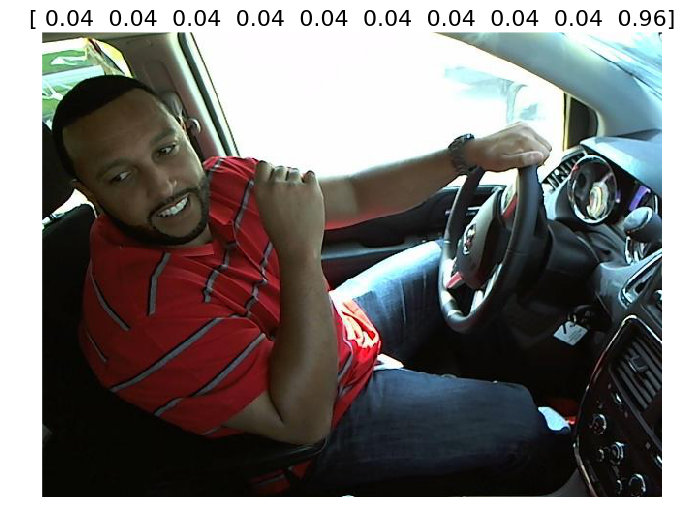

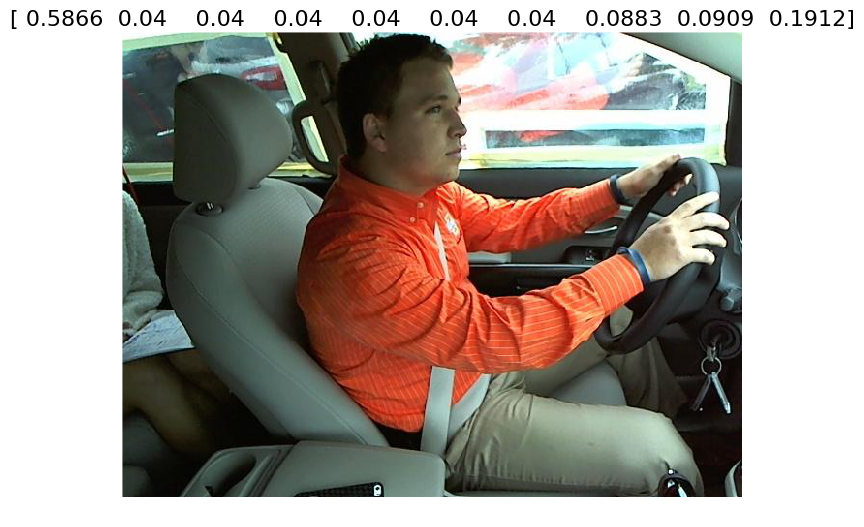

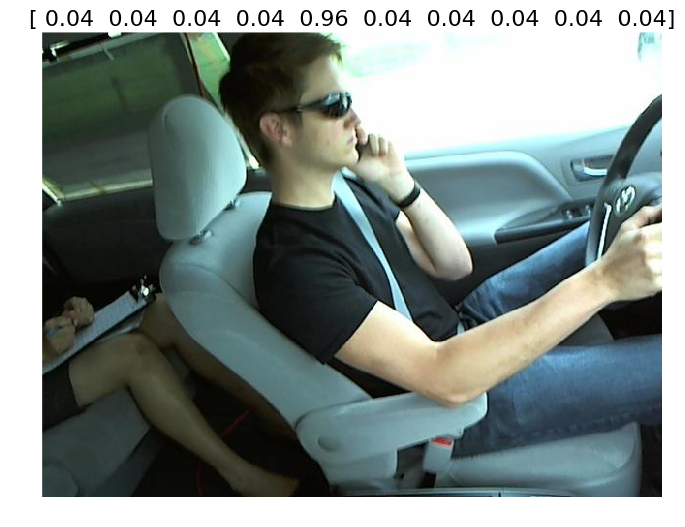

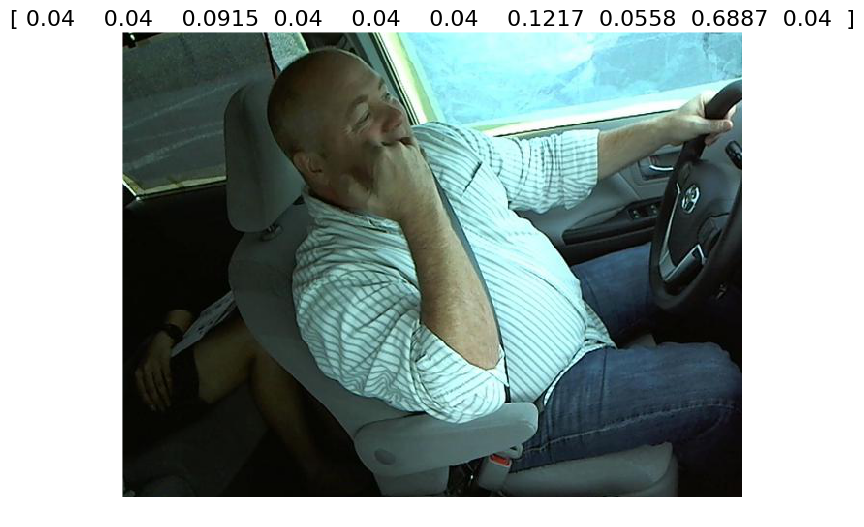

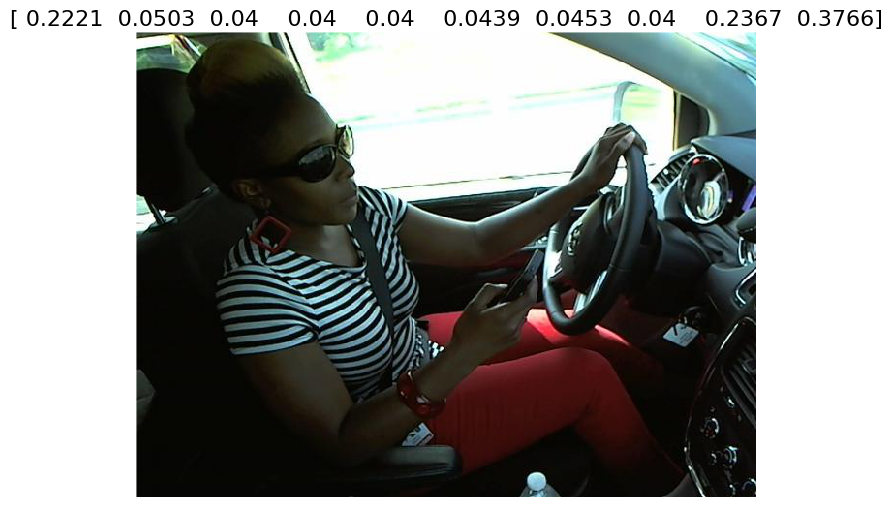

...

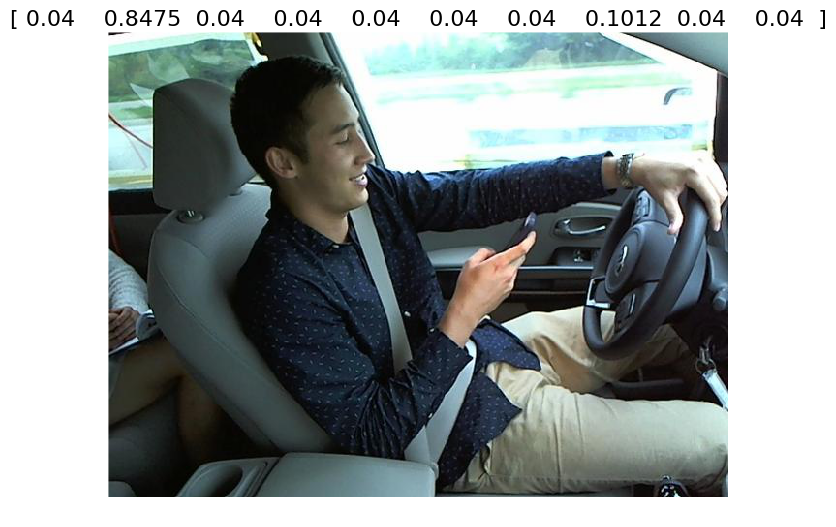

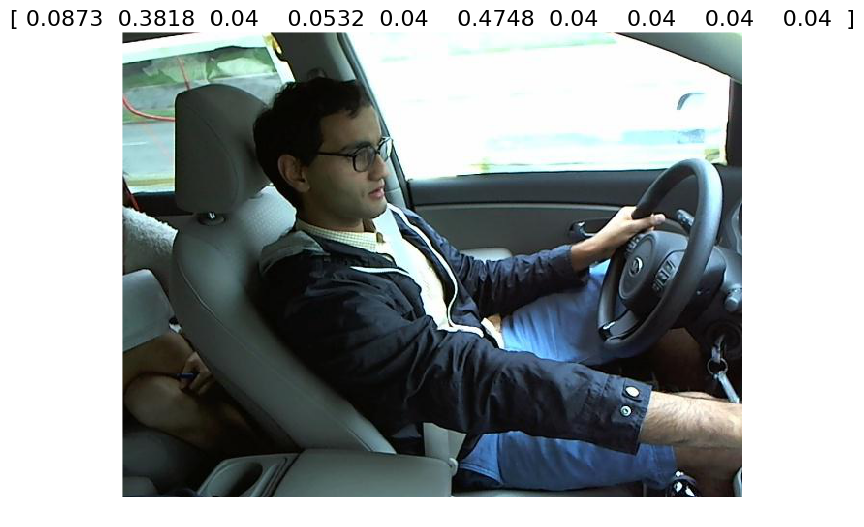

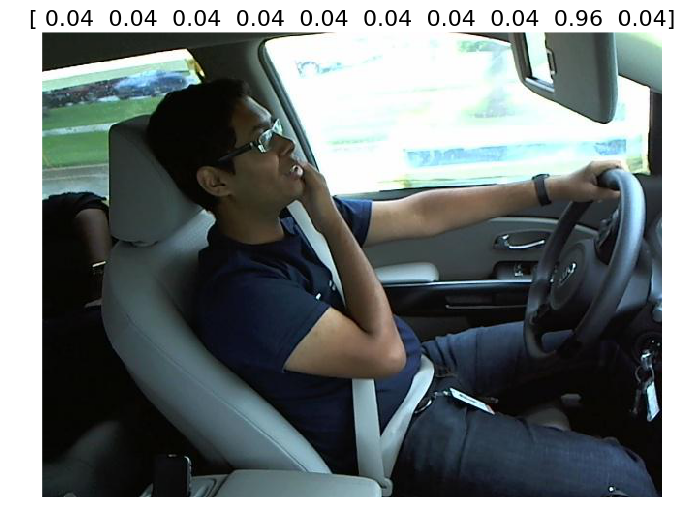

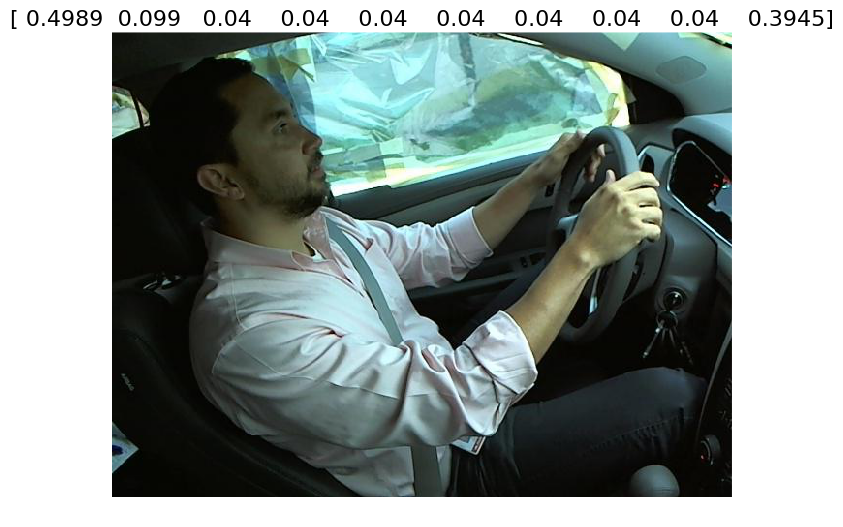

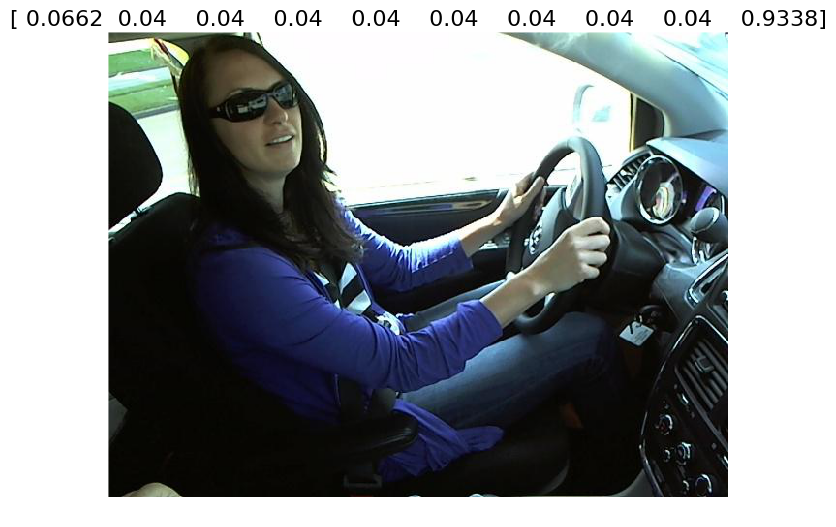

In [92]:
get_samples(test_batches, preds)

In [95]:
res = prepare_predictions(preds, test_batches.filenames)

In [96]:
res

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9
0,img_81601.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000
1,img_14887.jpg,0.586627,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.088312,0.090878,0.191218
2,img_62885.jpg,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000
3,img_45125.jpg,0.040000,0.040000,0.091494,0.040000,0.040000,0.040000,0.121667,0.055782,0.688702,0.040000
4,img_22633.jpg,0.222146,0.050345,0.040000,0.040000,0.040000,0.043851,0.045271,0.040000,0.236664,0.376602
5,img_45660.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
6,img_88962.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
7,img_92987.jpg,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000
8,img_26932.jpg,0.186097,0.200793,0.040000,0.313155,0.040000,0.040000,0.040000,0.040000,0.040000,0.297746
9,img_57972.jpg,0.040000,0.810133,0.040000,0.130639,0.040000,0.040000,0.040000,0.046293,0.040000,0.040000


In [97]:
write_csv(res, 'final-0.csv')

# Got Public: 0.89088 (34.79%) | Private: 0.89876 (34.652778%)

## Let's add Data augmentation and train one of the convolutional layers

### Trying out different augmentation options

In [38]:
# Create a sample with one image in order to more easily play around with the images
SINGLE_FILE_DIR = path + 'single-image/'
%mkdir -p '$SINGLE_FILE_DIR'cat1/
%cp '$train_path'c0/img_100050.jpg '$SINGLE_FILE_DIR'cat1/

In [39]:
# Create a Data Augmentation generator to augment the image
aug_gen = image.ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
#     shear_range=0.15,
    zoom_range=0.1,
)

In [113]:
# Create a one image batch
aug_sample_batch = get_batches(SINGLE_FILE_DIR, gen=aug_gen, batch_size=8, shuffle=False)

# Get 8 augmentations of the sample image
imgs = []
for i in range(8):
    img, lbl = next(aug_sample_batch)
    imgs.append(img)
imgs = np.array(imgs)

Found 1 images belonging to 1 classes.


[None, None, None, None, None, None, None, None]

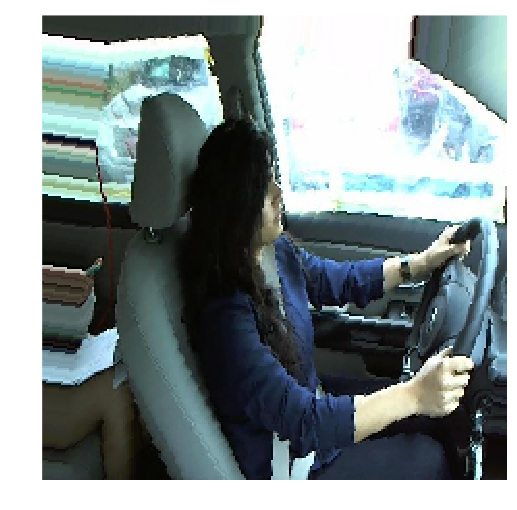

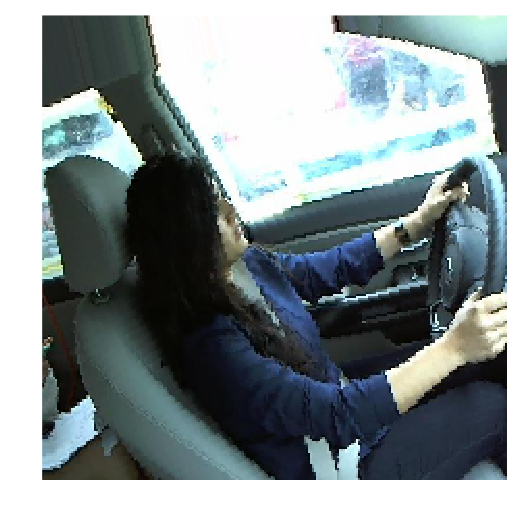

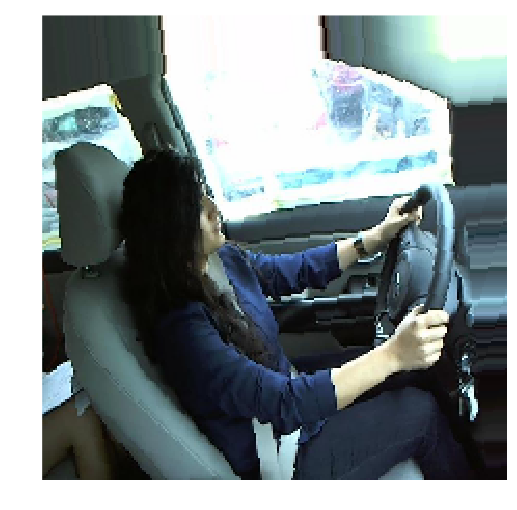

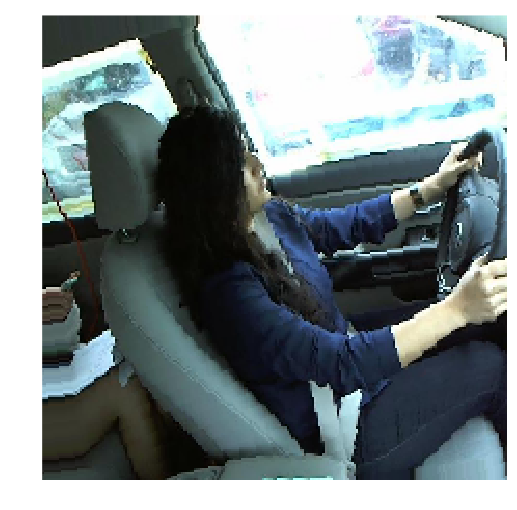

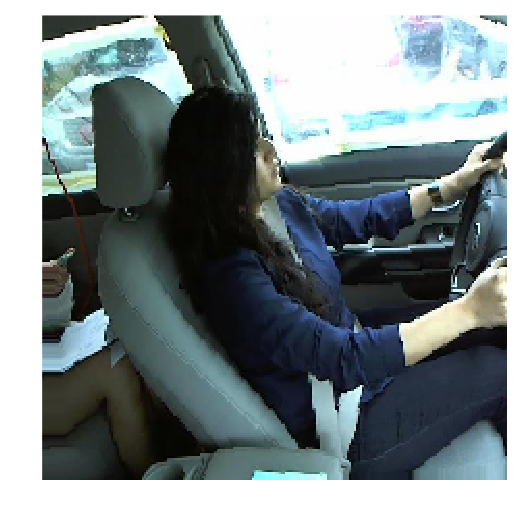

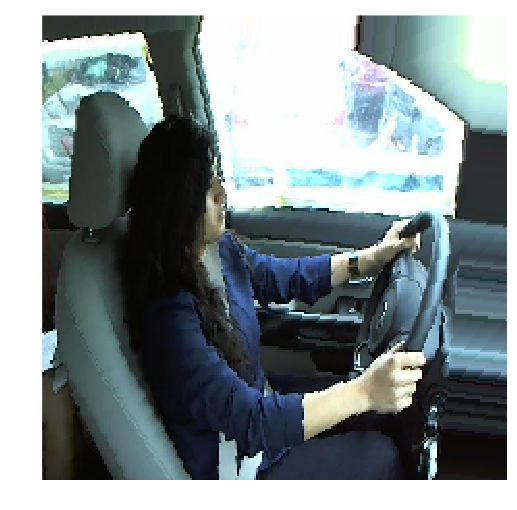

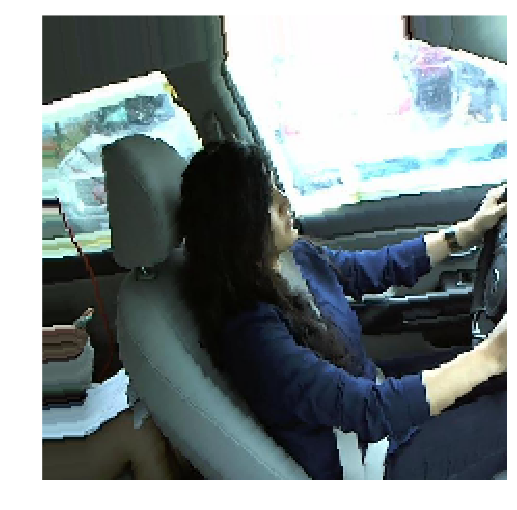

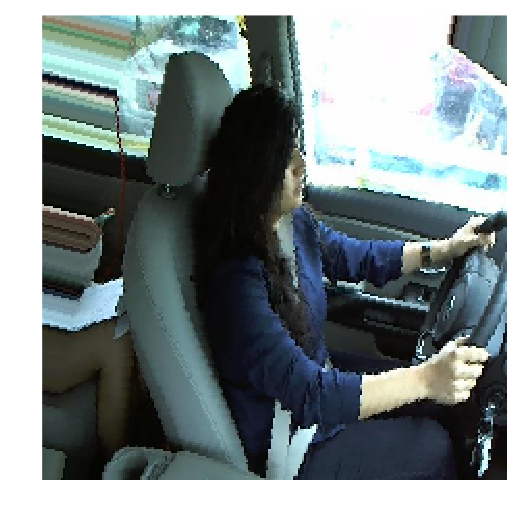

In [114]:
# Plot the results of 8 augmented images
[plots(img) for img in imgs]

### Use DA in the model

In [40]:
da_model = vgg16_with_bn()

In [41]:
da_model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
lambda_2 (Lambda)                (None, 3, 224, 224)   0           lambda_input_2[0][0]             
____________________________________________________________________________________________________
zeropadding2d_14 (ZeroPadding2D) (None, 3, 226, 226)   0           lambda_2[0][0]                   
____________________________________________________________________________________________________
convolution2d_14 (Convolution2D) (None, 64, 224, 224)  0           zeropadding2d_14[1][0]           
____________________________________________________________________________________________________
zeropadding2d_15 (ZeroPadding2D) (None, 64, 226, 226)  0           convolution2d_14[1][0]           
___________________________________________________________________________________________

In [42]:
# All layers from the last convolution layer are trainable, others are not.
max_non_trainable_layer_idx = flatten_layer_idx - 2
for i in range(0, max_non_trainable_layer_idx): da_model.layers[i].trainable = False

In [43]:
# Get the training/validation batches
batch_size = 64
trn_batches = get_batches(train_path, batch_size=batch_size, gen=aug_gen)
val_batches = get_batches(valid_path, batch_size=batch_size, shuffle=False)

Found 20187 images belonging to 10 classes.
Found 2237 images belonging to 10 classes.


In [128]:
da_model.fit_generator(
    trn_batches, samples_per_epoch=trn_batches.nb_sample, 
    nb_epoch=1, 
    validation_data=val_batches, nb_val_samples=val_batches.nb_sample
)

Epoch 1/1
20187/20187 [==============================] - 617s - loss: 0.3577 - acc: 0.8823 - val_loss: 0.0173 - val_acc: 0.9969


In [129]:
da_model.save_weights(model_path + 'ns-da-f1.h5f')

In [132]:
da_model.load_weights(model_path + 'ns-da-f1.h5f')

In [133]:
da_model.fit_generator(
    trn_batches, samples_per_epoch=trn_batches.nb_sample, 
    nb_epoch=1, 
    validation_data=val_batches, nb_val_samples=val_batches.nb_sample
)

Epoch 1/1
20187/20187 [==============================] - 619s - loss: 0.2073 - acc: 0.9321 - val_loss: 0.0207 - val_acc: 0.9946


In [134]:
da_model.save_weights(model_path + 'ns-da-f2.h5f')

In [135]:
da_model.load_weights(model_path + 'ns-da-f2.h5f')

### Make predictions based on da-f1

In [136]:
da_model.load_weights(model_path + 'da-f1.h5f')
test_batches, preds = do_preds(da_model)

Found 79726 images belonging to 1 classes.


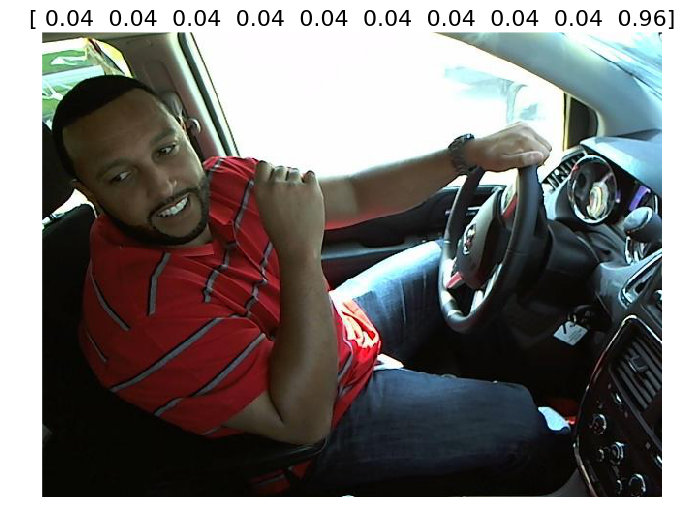

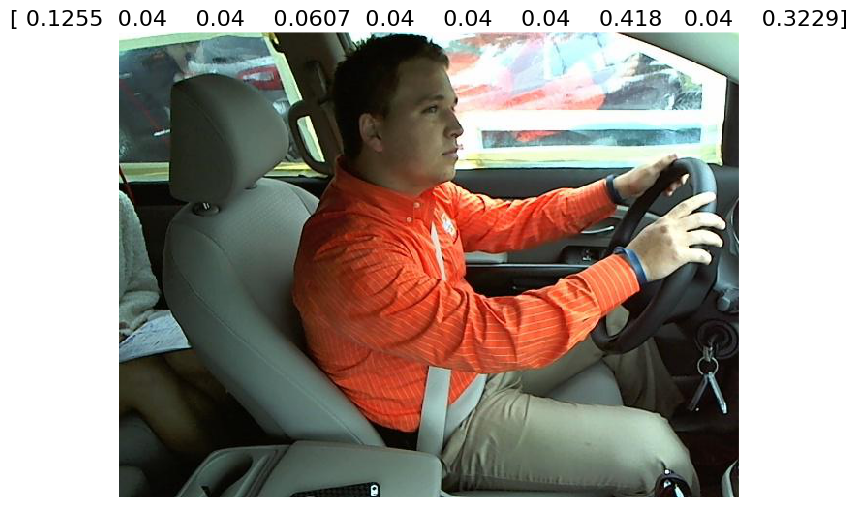

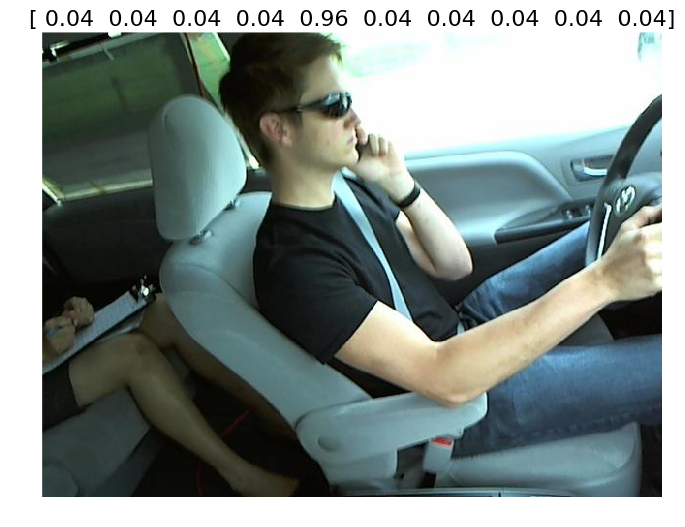

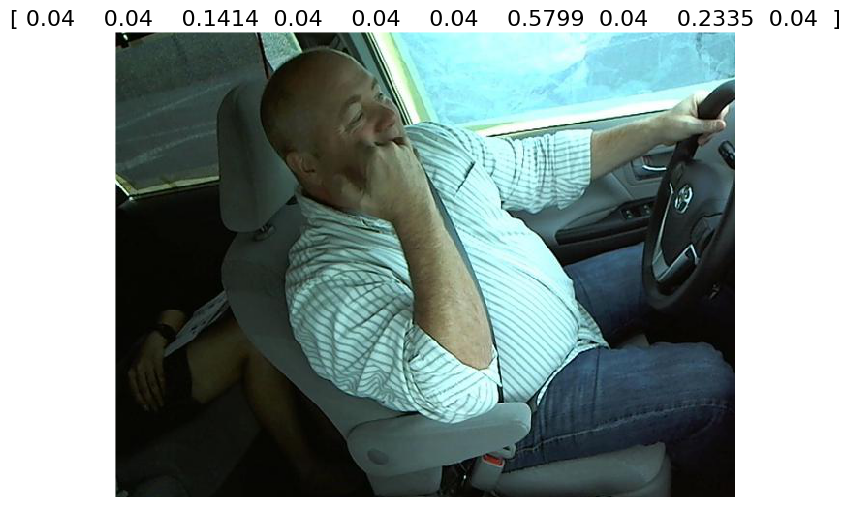

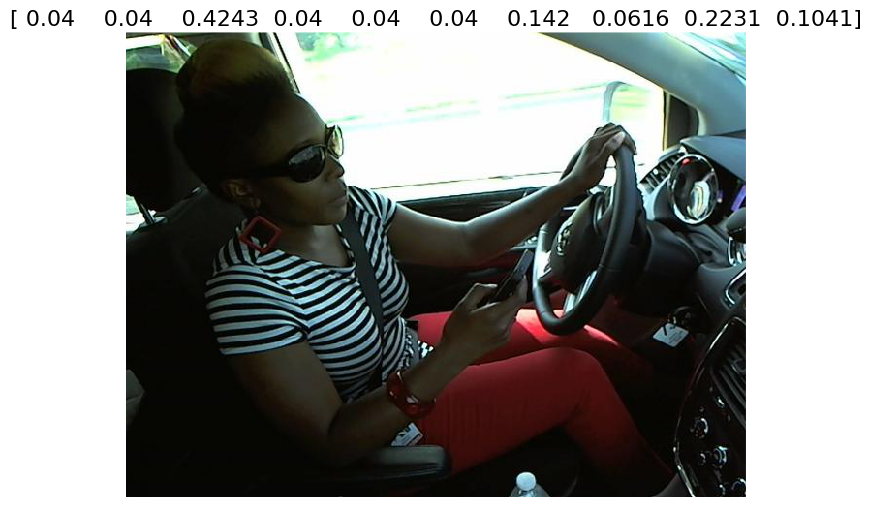

...

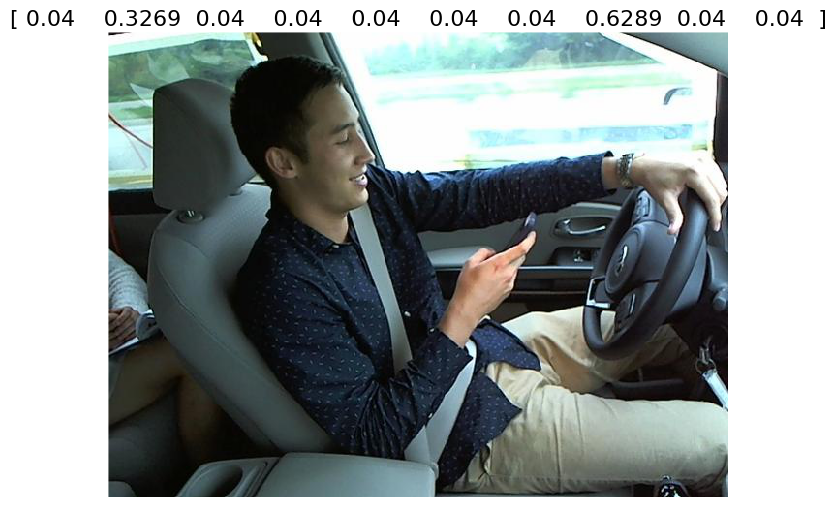

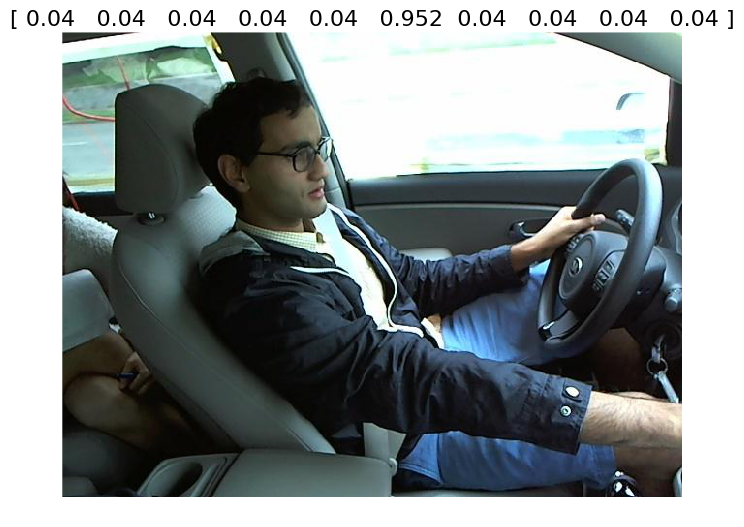

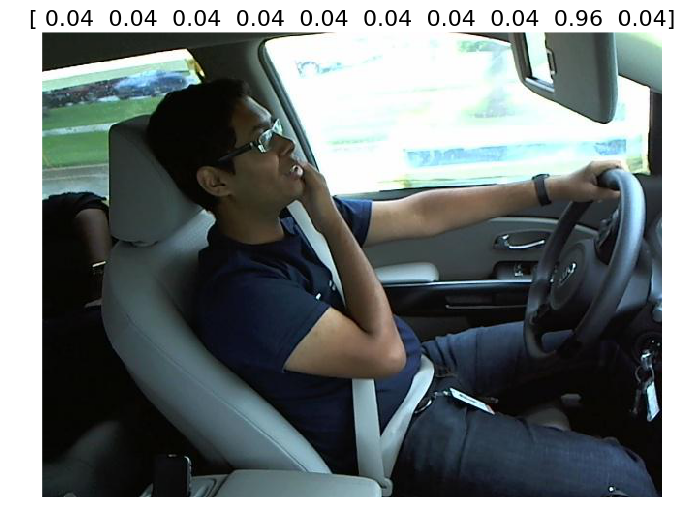

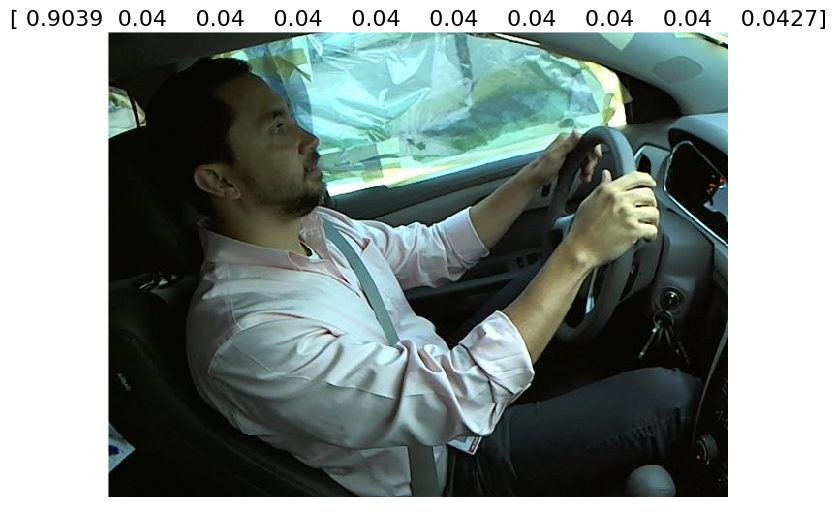

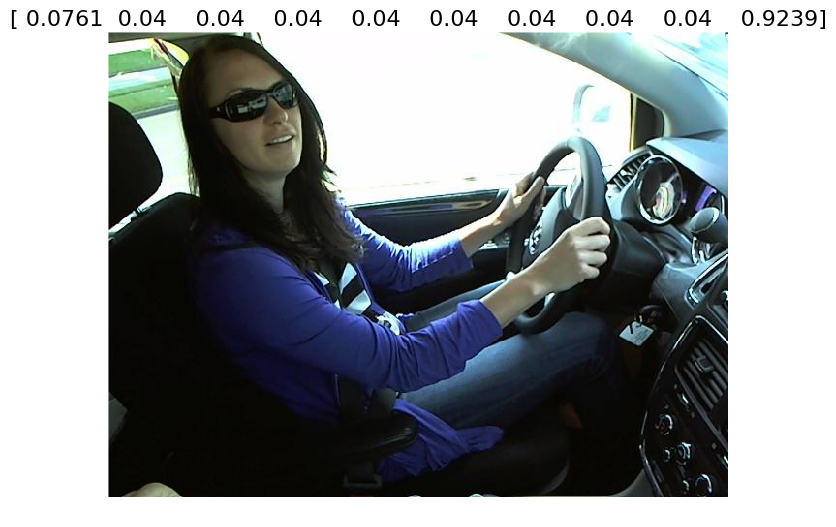

In [137]:
get_samples(test_batches, preds)

In [138]:
res = prepare_predictions(preds, test_batches.filenames)
res

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9
0,img_81601.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000
1,img_14887.jpg,0.125493,0.040000,0.040000,0.060693,0.040000,0.040000,0.040000,0.418019,0.040000,0.322947
2,img_62885.jpg,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000
3,img_45125.jpg,0.040000,0.040000,0.141426,0.040000,0.040000,0.040000,0.579888,0.040000,0.233475,0.040000
4,img_22633.jpg,0.040000,0.040000,0.424348,0.040000,0.040000,0.040000,0.141992,0.061585,0.223119,0.104115
5,img_45660.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
6,img_88962.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
7,img_92987.jpg,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000
8,img_26932.jpg,0.432989,0.040000,0.040000,0.422508,0.040000,0.040000,0.040000,0.040000,0.040000,0.105037
9,img_57972.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000


In [139]:
write_csv(res, 'da-f1.csv')

# Got Public:  (%) | Private:  (%) - not as good as final-0

### Try training from last Conv layer w/o DA

In [44]:
conv_train_model = vgg16_with_bn()

In [50]:
# All layers from the last convolution layer are trainable, others are not.
max_non_trainable_layer_idx = flatten_layer_idx - 2
for layer in conv_train_model.layers[:max_non_trainable_layer_idx]: layer.trainable = False
for layer in conv_train_model.layers[max_non_trainable_layer_idx:]: layer.trainable = True

In [46]:
conv_train_model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
lambda_3 (Lambda)                (None, 3, 224, 224)   0           lambda_input_3[0][0]             
____________________________________________________________________________________________________
zeropadding2d_27 (ZeroPadding2D) (None, 3, 226, 226)   0           lambda_3[0][0]                   
____________________________________________________________________________________________________
convolution2d_27 (Convolution2D) (None, 64, 224, 224)  0           zeropadding2d_27[1][0]           
____________________________________________________________________________________________________
zeropadding2d_28 (ZeroPadding2D) (None, 64, 226, 226)  0           convolution2d_27[1][0]           
___________________________________________________________________________________________

In [51]:
for layer in conv_train_model.layers: print(layer, layer.trainable)

(<keras.layers.core.Lambda object at 0x7fa33c39bb90>, False)
(<keras.layers.convolutional.ZeroPadding2D object at 0x7fa3c4aca250>, False)
(<keras.layers.convolutional.Convolution2D object at 0x7fa33c419590>, False)
(<keras.layers.convolutional.ZeroPadding2D object at 0x7fa3ddf7d190>, False)
(<keras.layers.convolutional.Convolution2D object at 0x7fa3ddf87110>, False)
(<keras.layers.pooling.MaxPooling2D object at 0x7fa3c4acaf90>, False)
(<keras.layers.convolutional.ZeroPadding2D object at 0x7fa3c4ad3c90>, False)
(<keras.layers.convolutional.Convolution2D object at 0x7fa33c7a9050>, False)
(<keras.layers.convolutional.ZeroPadding2D object at 0x7fa33c7b2fd0>, False)
(<keras.layers.convolutional.Convolution2D object at 0x7fa33c3994d0>, False)
(<keras.layers.pooling.MaxPooling2D object at 0x7fa3c4ad3810>, False)
(<keras.layers.convolutional.ZeroPadding2D object at 0x7fa33c3beb50>, False)
(<keras.layers.convolutional.Convolution2D object at 0x7fa33c42bcd0>, False)
(<keras.layers.convolutional.

In [52]:
trn_batches = get_batches(train_path, batch_size=batch_size)
val_batches = get_batches(valid_path, batch_size=batch_size, shuffle=False)

Found 20187 images belonging to 10 classes.
Found 2237 images belonging to 10 classes.


In [54]:
conv_train_model.fit_generator(
    trn_batches, 
    samples_per_epoch=trn_batches.nb_sample,
    nb_epoch=1,
    validation_data=val_batches,
    nb_val_samples=val_batches.nb_sample,
)

Epoch 1/1
20187/20187 [==============================] - 570s - loss: 0.0019 - acc: 0.9996 - val_loss: 0.0157 - val_acc: 0.9951


In [55]:
conv_train_model.save_weights(model_path + 'ns-1conv-f1.h5f')

In [56]:
conv_train_model.load_weights(model_path + 'ns-1conv-f1.h5f')

In [57]:
conv_train_model.fit_generator(
    trn_batches, 
    samples_per_epoch=trn_batches.nb_sample,
    nb_epoch=2,
    validation_data=val_batches,
    nb_val_samples=val_batches.nb_sample,
)

Epoch 1/2
20187/20187 [==============================] - 570s - loss: 0.0011 - acc: 0.9998 - val_loss: 0.0196 - val_acc: 0.9928
Epoch 2/2
20187/20187 [==============================] - 570s - loss: 7.3386e-04 - acc: 0.9998 - val_loss: 0.0129 - val_acc: 0.9955


In [58]:
conv_train_model.save_weights(model_path + 'ns-1conv-f3.h5f')

In [59]:
conv_train_model.load_weights(model_path + 'ns-1conv-f3.h5f')

In [60]:
test_batches, preds = do_preds(conv_train_model)

Found 79726 images belonging to 1 classes.


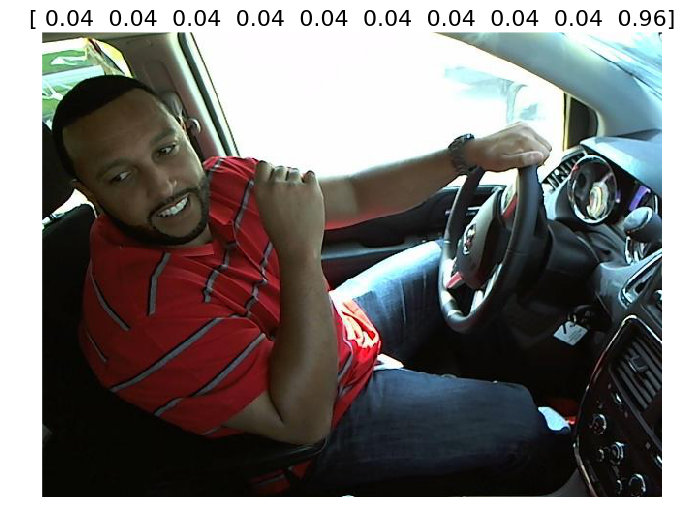

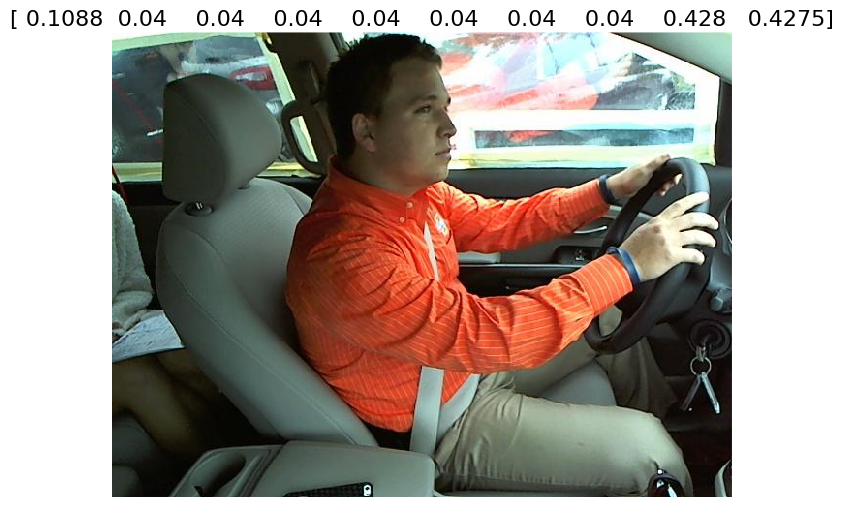

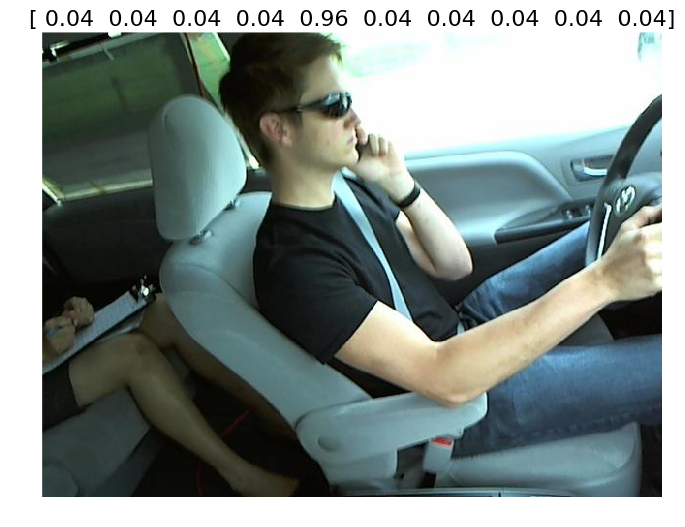

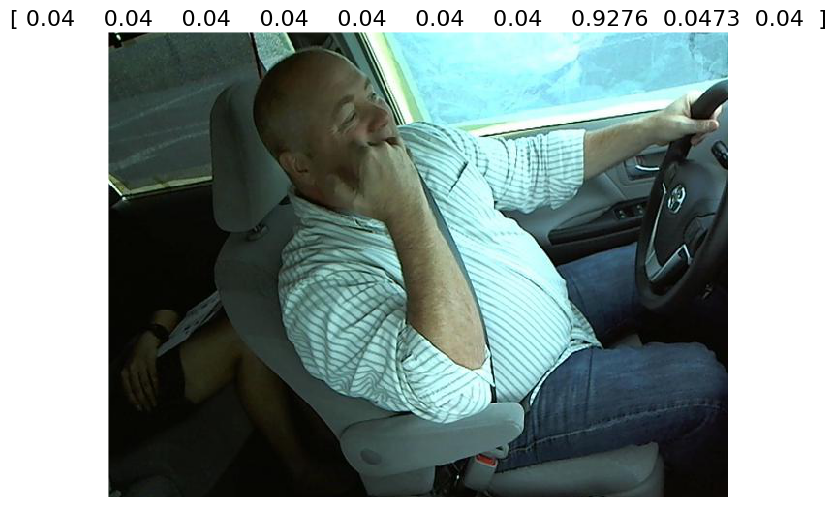

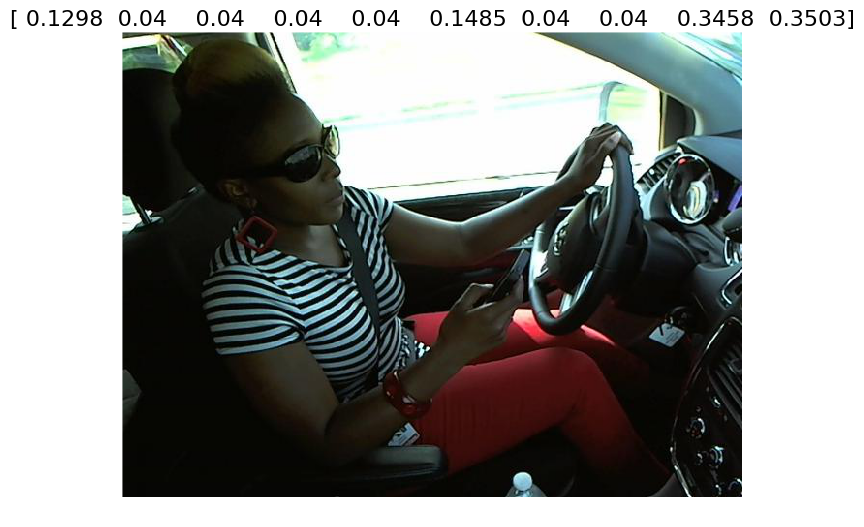

...

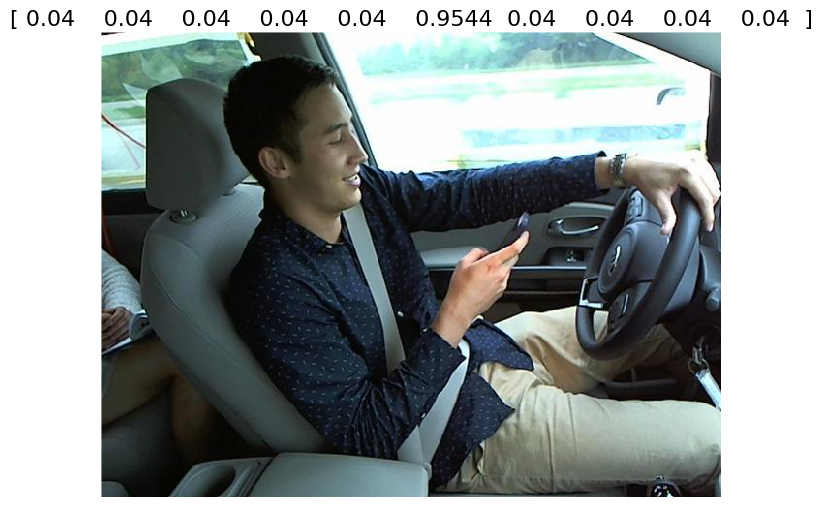

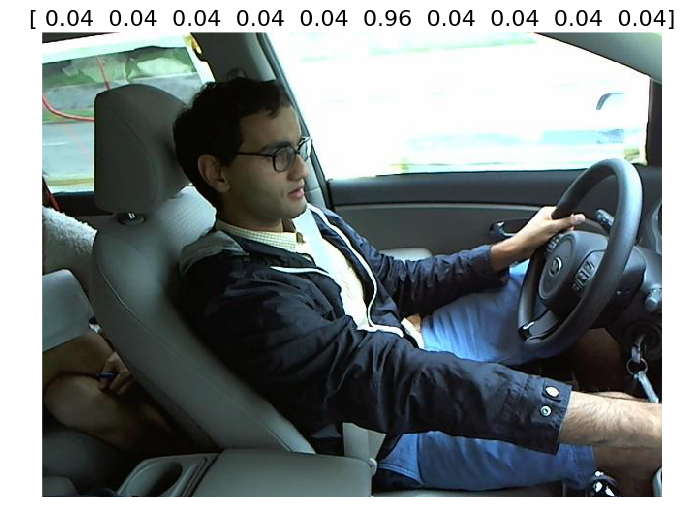

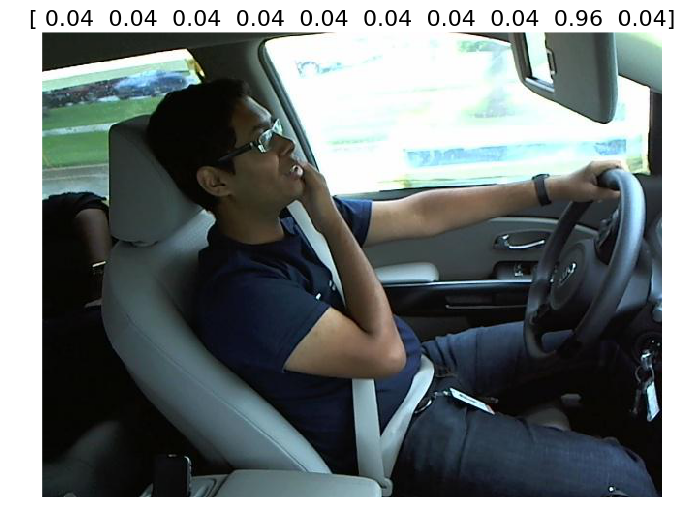

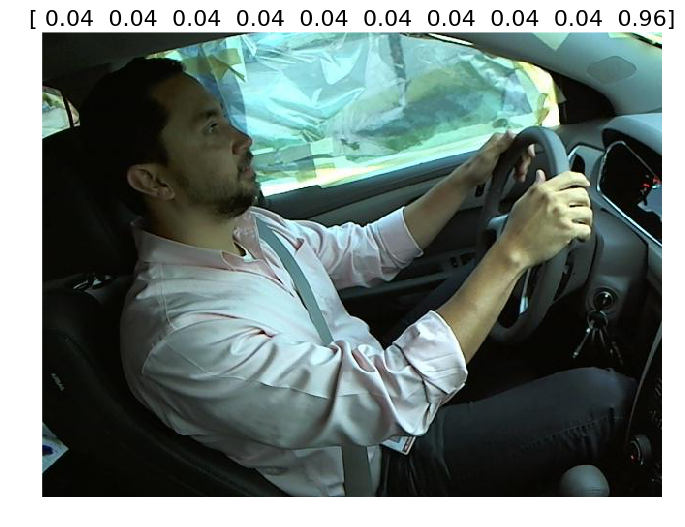

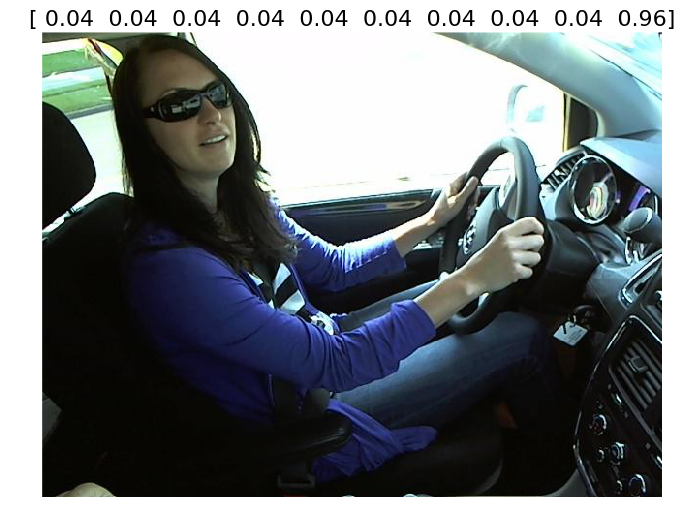

In [61]:
get_samples(test_batches, preds)

In [62]:
res = prepare_predictions(preds, test_batches.filenames)
res

,img,c0,c1,c2,c3,c4,c5,c6,c7,c8,c9
0,img_81601.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000
1,img_14887.jpg,0.108785,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.427996,0.427527
2,img_62885.jpg,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000
3,img_45125.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.927552,0.047318,0.040000
4,img_22633.jpg,0.129828,0.040000,0.040000,0.040000,0.040000,0.148484,0.040000,0.040000,0.345807,0.350280
5,img_45660.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
6,img_88962.jpg,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.960000,0.040000,0.040000
7,img_92987.jpg,0.040000,0.040000,0.960000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000,0.040000
8,img_26932.jpg,0.040000,0.040000,0.040000,0.103297,0.040000,0.040000,0.040000,0.040000,0.040000,0.848875
9,img_57972.jpg,0.040000,0.094717,0.040000,0.508117,0.069046,0.040000,0.040000,0.233383,0.040000,0.058749


In [63]:
write_csv(res, 'conv-train-f3.csv')